# ¿Qué hay en los datos?

En los datos encontrarás información de las **exportaciones e importaciones de Colombia de 1962 a 2017**. Fueron extraídos del [OEC: The Observatory of Economic Complexity](https://legacy.oec.world/en/).


## Preguntas

Preguntas a resolver con el desarrollo del analisis:

1. ¿Cuál es el top 10 países a los que Colombia exporta sus productos y su evolución con respecto al tiempo?
2. ¿Cuál es el top 10 países de los que Colombia importa sus productos y su evolución con respecto al tiempo?
3. ¿Existe algún producto que debido a cambios económicos en la oferta/demanda halla causado un decremento en el volumen de dinero que se mueve con él?
4. ¿Cuáles sectores económicos tienen mayor importancia en las exportaciones de Colombia y por qué?

# Extraccion, Limpieza y transformación de datos 


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
pd.options.display.float_format = '{:,.3f}'.format
%matplotlib inline

In [2]:
%cd d:\Documents\db\data_triatlon
!ls

d:\Documents\db\data_triatlon
colombia_exports.csv
colombia_imports.csv
country_names.csv
groups_sitc_rev2.csv
products_sitc_rev2.csv


limpieza de los datos:

In [3]:
df_exports=pd.read_csv('colombia_exports.csv', sep='|')
df_exports.drop(['Unnamed: 0'], axis=1, inplace=True)
df_exports.drop(['Unnamed: 0.1'], axis=1, inplace=True)
df_exports.isna().any()
df_exports.rename(columns={'sitc4':'sitc'}, inplace=True)
df_exports.rename(columns={'dest':'pais'}, inplace=True)
df_exports

,year,origin,pais,sitc,export_val
0,1962,col,civ,1210,"12,000.000"
1,1962,col,dza,1210,"112,000.000"
2,1962,col,egy,2472,"6,000.000"
3,1962,col,mar,1210,"164,000.000"
4,1962,col,mar,711,"5,000.000"
...,...,...,...,...,...
389591,2017,col,ury,6635,"26,526.500"
389592,2017,col,ury,8924,"4,285.500"
389593,2017,col,ury,8928,"25,667.500"
389594,2017,col,ury,8972,"5,306.000"


In [23]:
df_sitc_prod=pd.read_csv('products_sitc_rev2.csv', sep='|')
df_sitc_prod.drop(['Unnamed: 0'], axis=1, inplace=True)
df_sitc_prod.isna().any()
df_sitc_prod.head(20)

,id,sitc,name
0,105722,5722,Initiating Devices
1,105838,5838,Polymerization Ion Exchangers
2,106250,6250,"Rubber tires, tire cases, inner and flaps, for..."
3,106251,6251,Car Tires
4,106280,6280,Other articles of rubber
5,106282,6282,Transmission Belts
6,106289,6289,Miscellaneous Rubber
7,106352,6352,Casks and Barrels
8,106418,6418,Coated Paper
9,106572,6572,Bonded Fiber Fabrics


In [136]:
df_sitc_group=pd.read_csv('groups_sitc_rev2.csv', sep='|')
# df_sitc_group.drop(['Unnamed: 0'], axis=1, inplace=True)
df_sitc_group.isna().any()
df_sitc_group.head(30)

,Unnamed: 0,id,category
0,1,0,Live animals other than animals of division 03
1,2,1,Meat and meat preparations
2,3,2,Dairy products and birds' eggs
3,4,3,"Fish, crustaceans, molluscs and preparations t..."
4,5,4,Cereals and cereal preparations
5,6,5,Vegetables and fruits
6,7,6,"Sugar, sugar preparations and honey"
7,8,7,"Coffee, tea, cocoa, spices, and manufactures t..."
8,9,8,Feedstuff for animals (excluding unmilled cere...
9,10,9,Miscellaneous edible products and preparations


In [6]:
df_country_names=pd.read_csv('country_names.csv', sep='|')
df_country_names.drop(['Unnamed: 0'], axis=1, inplace=True)
df_country_names.rename(columns={'id_3char':'pais'}, inplace=True)
df_country_names.isna().any()
df_country_names.drop_duplicates()

,id,pais,name
0,afago,ago,Angola
1,afbdi,bdi,Burundi
2,afben,ben,Benin
3,afbfa,bfa,Burkina Faso
4,afbwa,bwa,Botswana
...,...,...,...
258,sasur,sur,Suriname
259,saury,ury,Uruguay
260,saven,ven,Venezuela
261,xxwld,wld,World


In [7]:
df_imports=pd.read_csv('colombia_imports.csv', '|')
df_imports.drop(['Unnamed: 0'], axis=1, inplace=True)
df_imports.drop(['Unnamed: 0.1'], axis=1, inplace=True)
df_imports.drop(['dest'], axis=1, inplace=True)
df_imports.isna().any()
df_imports.rename(columns={'sitc4':'sitc'}, inplace=True)
df_imports.rename(columns={'origin':'pais'}, inplace=True)
df_imports



,year,pais,sitc,export_val
0,1962,civ,712,"13,000.000"
1,1962,cod,2925,"2,000.000"
2,1962,cog,2925,"2,000.000"
3,1962,egy,2631,"40,000.000"
4,1962,eth,2922,"4,000.000"
...,...,...,...,...
560487,2017,ury,5833,231.500
560488,2017,ury,6658,"8,658.000"
560489,2017,ury,8928,"3,816.500"
560490,2017,ury,8972,500.000


realizo un merge entre el los dataframes df_exports, df_sitc_prod y df_countrynames, y tener un solo dataframe el valor de exportacion y el nombre del producto:

In [8]:
# mergin de los dataframes:
df=pd.merge(df_exports, df_sitc_prod, how='inner', on='sitc')
df1=pd.merge(df, df_country_names, how='inner', on='pais')

#renombro y elimino algunas columnas
df1.rename(columns={'name_x':'product', 'name_y':'nombre_pais','pais':'dest'}, inplace=True)
df_clean_exports=df1.drop(['id_x', 'id_y', 'origin'], axis=1)

#reordeno las columnas
df_clean_exports=df_clean_exports[['year', 'dest', 'nombre_pais', 'sitc','product','export_val']]

df_clean_exports['year']=pd.to_datetime(df_clean_exports['year'], format="%Y")
df_clean_exports['year']=pd.DatetimeIndex(df_clean_exports['year']).year
df_clean_exports

,year,dest,nombre_pais,sitc,product,export_val
0,1962,civ,Cote d'Ivoire,1210,Tobacco unmanufactured; tobacco refuse,"12,000.000"
1,1971,civ,Cote d'Ivoire,1210,Tobacco unmanufactured; tobacco refuse,"9,000.000"
2,1972,civ,Cote d'Ivoire,1210,Tobacco unmanufactured; tobacco refuse,"7,000.000"
3,1973,civ,Cote d'Ivoire,1210,Tobacco unmanufactured; tobacco refuse,"22,000.000"
4,1974,civ,Cote d'Ivoire,1210,Tobacco unmanufactured; tobacco refuse,"29,000.000"
...,...,...,...,...,...,...
388059,1997,mnp,Northern Mariana Islands,6542,Woven Frabrics of More Than 85% Wool,"55,770.000"
388060,1999,mnp,Northern Mariana Islands,6542,Woven Frabrics of More Than 85% Wool,"216,156.000"
388061,2001,mnp,Northern Mariana Islands,6542,Woven Frabrics of More Than 85% Wool,"240,122.000"
388062,2004,mnp,Northern Mariana Islands,7525,Computer Peripherals,"2,170.000"


In [9]:
#hago el mismo procedimiento para tener un datframe con los valores de importacion
df_clean_imports=pd.merge(pd.merge(df_imports, df_sitc_prod, how='inner', on='sitc'), df_country_names, how='inner', on='pais')
df_clean_imports.rename(columns={'name_x':'product', 'name_y':'nombre_pais', 'export_val':'import_val', 'pais':'origin'}, inplace=True)
df_clean_imports=df_clean_imports.drop(['id_x', 'id_y'], axis=1)
df_clean_imports=df_clean_imports[['year', 'origin', 'nombre_pais', 'sitc','product','import_val']]
df_clean_imports

,year,origin,nombre_pais,sitc,product,import_val
0,1962,civ,Cote d'Ivoire,712,Coffee Extracts,"13,000.000"
1,1963,civ,Cote d'Ivoire,2925,Planting Seeds and Spores,"16,000.000"
2,1964,civ,Cote d'Ivoire,2925,Planting Seeds and Spores,"26,000.000"
3,1965,civ,Cote d'Ivoire,2925,Planting Seeds and Spores,"2,000.000"
4,1966,civ,Cote d'Ivoire,2925,Planting Seeds and Spores,"2,000.000"
...,...,...,...,...,...,...
559521,2003,mnp,Northern Mariana Islands,8451,Knitted Outerwear,137.000
559522,2006,mnp,Northern Mariana Islands,8451,Knitted Outerwear,"1,420.000"
559523,2007,mnp,Northern Mariana Islands,8433,Dresses,846.000
559524,2006,mnp,Northern Mariana Islands,8434,Skirts,300.000


los dataframes, df_clean_exports/imports; seran las principales fuentes de datos, para usar la librerias de vizualizacion y responders algunas preguntas relacionadas a las  importaciones y exportaciones en colombia

**¿Cuál es el top 10 países a los que Colombia exporta sus productos?**:

In [10]:

exp_countriestop10=df_clean_exports.groupby(['nombre_pais'])['export_val'].sum().to_frame().sort_values(by=['export_val'], ascending=False).head(10)
exp_countriestop10

,export_val
nombre_pais,
United States,"260,603,708,738.500"
World,"73,055,836,595.000"
Venezuela,"42,876,466,095.000"
Germany,"29,901,242,862.000"
China,"28,098,899,858.000"
Ecuador,"27,910,876,776.500"
Netherlands,"23,378,757,615.500"
Spain,"22,173,799,276.000"
Peru,"20,931,290,140.000"


**¿Cuál es el top 10 países a los que Colombia exporta sus productos?:**

In [11]:
imp_countriestop10=df_clean_imports.groupby(['nombre_pais'])['import_val'].sum().to_frame().sort_values(by=['import_val'], ascending=False).head(10)
imp_countriestop10

,import_val
nombre_pais,
United States,"208,775,367,635.000"
China,"70,886,767,865.000"
Mexico,"50,381,232,668.000"
World,"40,858,390,000.000"
Brazil,"37,505,000,015.000"
Germany,"33,274,792,793.000"
Japan,"30,389,407,789.000"
Venezuela,"21,775,270,653.000"
France,"18,302,265,933.500"


podemos vizualizar como se comportado el valor de exportacion a lo largo del tiempo (1962 - 2017), para construyo una tabla pivot para tener los datos mejor organizados y solo con los paises del top 10 en ewxportaciones

In [12]:
exp_countriestop10.index

Index(['United States', 'World', 'Venezuela', 'Germany', 'China', 'Ecuador',
       'Netherlands', 'Spain', 'Peru', 'Panama'],
      dtype='object', name='nombre_pais')

In [128]:
#filtrando los paises del top_10 en exportaciones, agrupamos por año y pais
df_top10_countries=df_clean_exports.loc[df_clean_exports['nombre_pais'].isin(exp_countriestop10.index)].groupby(['year','nombre_pais'])['export_val'].sum().to_frame()

# creamos tabla pivot
df_top10_countries=df_top10_countries.reset_index().pivot_table(values='export_val', index='year', columns='nombre_pais')

df_top10_countries.head()

nombre_pais,China,Ecuador,Germany,Netherlands,Panama,Peru,Spain,United States,Venezuela,World
year,,,,,,,,,,
1962,"13,000.000","1,938,000.000","74,222,000.000","24,074,000.000","294,000.000","4,699,000.000","6,756,000.000","274,294,000.000","1,089,000.000","492,286,000.000"
1963,NaN,"2,247,000.000","75,283,000.000","17,360,000.000","457,000.000","2,272,000.000","14,521,000.000","247,723,000.000","897,000.000","494,330,000.000"
1964,NaN,"3,913,000.000","78,998,000.000","20,073,000.000","3,910,000.000","3,150,000.000","20,452,000.000","278,731,000.000","2,182,000.000","564,293,000.000"
1965,NaN,"4,491,000.000","93,531,000.000","24,843,000.000","2,882,000.000","4,525,000.000","32,023,000.000","276,736,000.000","3,286,000.000","630,588,000.000"
1966,NaN,"4,963,000.000","82,054,000.000","19,283,000.000","1,906,000.000","12,858,000.000","26,050,000.000","244,820,000.000","3,428,000.000","588,325,000.000"


In [129]:
df_top10_countries_imp=df_clean_imports.loc[df_clean_imports['nombre_pais'].isin(imp_countriestop10.index)].groupby(['year','nombre_pais'])['import_val'].sum().to_frame()

# creamos tabla pivot
df_top10_countries_imp=df_top10_countries_imp.reset_index().pivot_table(values='import_val', index='year', columns='nombre_pais')

df_top10_countries_imp.head()

nombre_pais,Brazil,China,France,Germany,Japan,Mexico,South Korea,United States,Venezuela,World
year,,,,,,,,,,
1962,"144,000.000","14,000.000","12,392,000.000","54,884,000.000","17,318,000.000","1,643,000.000",NaN,"269,783,000.000","253,000.000","534,429,000.000"
1963,"537,000.000","3,000.000","7,330,000.000","49,820,000.000","19,237,000.000","3,692,000.000",NaN,"233,256,000.000","252,000.000","464,155,000.000"
1964,"1,849,000.000",NaN,"12,937,000.000","62,090,000.000","26,025,000.000","5,240,000.000",NaN,"272,874,000.000","1,640,000.000","585,424,000.000"
1965,"3,560,000.000","51,000.000","6,762,000.000","57,266,000.000","15,906,000.000","5,981,000.000",NaN,"211,992,000.000","686,000.000","453,432,000.000"
1966,"7,544,000.000","1,000.000","11,542,000.000","79,094,000.000","27,731,000.000","9,641,000.000","9,000.000","312,282,000.000","1,585,000.000","674,119,000.000"


In [15]:
# librerias para vizualizacion
import plotly.graph_objects as go
import seaborn as sns

<AxesSubplot:xlabel='year'>

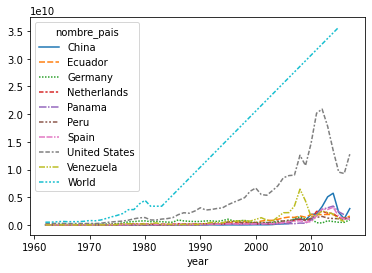

In [16]:
# graficado con seaborn
sns.lineplot(data=df_top10_countries)

en la grafica anterior se muestra la evolucion del valor de exportaicion a lo largo de los años, se logra observar de deste el año 1962  en genral el valor de exportacion ha aumentado, este aumento ha sido considerablemente mayor con respecto a USA

para las importaciones tedremos lo siguiente:

<AxesSubplot:xlabel='year'>

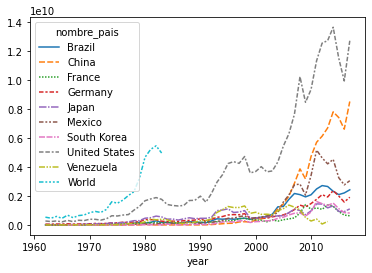

In [17]:
sns.lineplot(data=df_top10_countries_imp)

podemos generar una mejor vizualizacion con la libreria plotly, la cual nos genera un grafico mas dinamico, nos permitira hacer zoom en la seccion que queramos del grafico

In [118]:
import plotly.graph_objects as go

In [120]:
# estas lineas solo son necesarias para poder vizualizar las graficas de plotly en VScode, en caso de visualizar este notebook con otra herramienta como google colab o un servidor estandar de jupyter, no seran necesarias
import plotly.io as pio
pio.renderers.default = "vscode"

In [126]:
fig = go.Figure()
for pais in df_top10_countries.columns:
  fig.add_trace(go.Scatter(x=df_top10_countries.index, y=df_top10_countries[pais], mode='lines+markers', name=pais))
fig.update_xaxes(title_text='Year')
fig.update_yaxes(title_text='Export Value')
fig.show()


In [125]:
fig = go.Figure()
for pais in df_top10_countries_imp.columns:
  fig.add_trace(go.Scatter(x=df_top10_countries_imp.index, y=df_top10_countries_imp[pais], mode='lines+markers', name=pais))
fig.update_xaxes(title_text='Year')
fig.update_yaxes(title_text='Export Value')
fig.show()

haciendo un poco de zoom en la areas abarcadas por los años 2000 - 2017 para el grafico de importaciones se puede observar que hubo un aumento considerable en la exportaciones a venezueala desde el 2002 la cual empezo a disminuir considerablemente en el, este mismo comportamiento se aprecia en las exportaciones a estados unidos con la diferencia de que estas empezaron a decar en el 2012 y con valores de exportacion mucho mayores

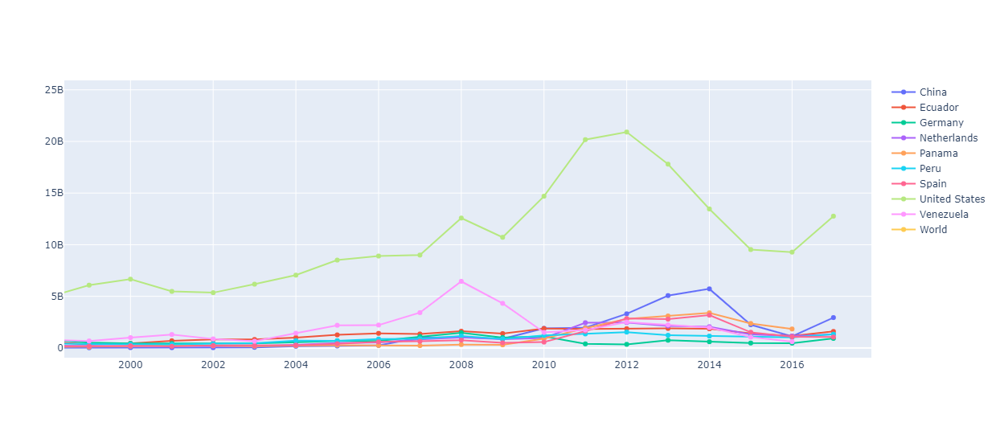

Podemos obtener algo de informacion adicional con un stacked Bar chart

**¿Cuáles sectores económicos tienen mayor importancia en las exportaciones de Colombia y por qué?**

para responder este inciso, Podemos obtener algo de informacion adicional con un stacked Bar chart, teniendo en cuenta los productos con que han generado un mayo valor de exportacion a lo largo de los años, (1962-2017)

In [91]:
#top 10 de productos con mayor valor de exportacion 
df_top10_prod=df_clean_exports.groupby(['product'])['export_val'].sum().to_frame().sort_values(by='export_val', ascending=False).head(10)
df_top10_prod

,export_val
product,
Crude Petroleum,"221,163,722,163.500"
Coffee,"108,573,167,285.500"
Coal,"90,629,137,301.000"
Bananas,"32,537,835,176.000"
Flowers,"26,361,521,091.500"
Gold,"21,236,827,827.000"
Lubricating Petroleum Oils,"15,737,724,471.500"
Unclassified Transactions,"13,499,524,570.500"
Ferro-alloys,"13,202,390,906.500"


In [138]:
df_t=df_clean_exports.loc[df_clean_exports['nombre_pais'].isin(exp_countriestop10.index)]
df_t=df_t.loc[df_t['product'].isin(df_top10_prod.index)] #valor de exportacion por producto solo en los paises con con los que se han generado el mayor valor de exportacion (Top 10)

df_t2=df_clean_exports.loc[df_clean_exports['nombre_pais'].isin(exp_countriestop10.index)]

asi podemos generar un Stacked Bar Chart para saber cuales son los productos que mas contribuyen a al valor de exportacion de total hacia cada pais, 

In [135]:
import plotly.express as px

fig = px.bar(df_t, x="nombre_pais", y="export_val", color="product", title="dist. Export Val. in Products")
fig.update_xaxes(title_text='Country')
fig.update_yaxes(title_text='Export Value')
fig.show()

con lo anterior podriamos decir que el sector de mayor relevaci ha sido el sector minero energetico, pues, entro los productos mas relevantes, se encuentra el oro (Gold), carbon (Coal), aleaciones de hierro (ferro-alloys), petroleo crudo y algunos de sus derivados,

no obstante el sector agrigultor y manufacturero tambien han influido considerablemente en el valor total, gracias a las exportaciones de flores, bananos y cafe

se puede notar las barras de los paises venezuela, ecuadro y peru, son las mas pequeñas, esto se debe a que, de los 10 productos mas exportados por colombia los medicamentos y transacciones no clasifacadas, solo contribuyen en nun pequeña parte a suvalor de exportacion total, sin embargo esto no significa que el valor generado por exporataciones a estos paises sea pequeño,

para entender esto ultimo de un mejor manera, podemos crear un stacked barchart, cosiderando todos los productos que se exportan, y no solamente los 10 mas exportados

In [142]:
import altair as alt #libreria para visualizacion, permite exportar en formatos como svg y png
alt.data_transformers.disable_max_rows()

alt.Chart(df_t2).mark_bar(
    cornerRadiusTopLeft=3,
    cornerRadiusTopRight=3
).encode(
    x='nombre_pais:O',
    y='export_val:Q',
    color='product:N'
)

alt.Chart(...)

aqui podemos ver que para que  la variedad de productos que se exportan a venezuela, ecuador y peru, es mucho mayor

In [94]:
# df_t.groupby(['product'])['export_val'].sum().to_frame().sort_values(by='export_val', ascending=False)

,export_val
product,
Crude Petroleum,"182,184,527,645.000"
Coffee,"71,787,609,943.000"
Coal,"41,215,274,899.000"
Flowers,"20,964,567,845.500"
Gold,"16,229,464,495.000"
Bananas,"15,885,631,577.500"
Unclassified Transactions,"10,902,509,584.000"
Lubricating Petroleum Oils,"10,218,715,920.500"
Ferro-alloys,"7,253,888,737.500"


In [141]:
alt.Chart(df_t2).mark_bar(
    cornerRadiusTopLeft=3,
    cornerRadiusTopRight=3
).encode(
    x='nombre_pais:O',
    y='export_val:Q',
    color='product:N'
)

alt.Chart(...)

Tambien podemos considerar la evolucion del valor de exportacion en el top 10 de los paises con respecto a los años,  

In [148]:
df_t_pitvot=df_clean_exports.groupby(['year', 'product'])['export_val'].sum().to_frame().reset_index().pivot_table(values='export_val', index='year', columns='product')

In [152]:
fig = go.Figure()
for product in df_top10_prod.index:
  fig.add_trace(go.Scatter(x=df_t_pitvot.index, y=df_t_pitvot[product], mode='lines+markers', name=product))

# fig.update_xaxes(title_text='Year')
# fig.update_yaxes(title_text='Export Value')
# fig.update_title(title_text='Export Val. by producto vs Year')

fig.update_layout(
    title="Export Val. by producto vs Year",
    xaxis_title="Year",
    yaxis_title="Export Value",
    legend_title="Legend Title")

fig.show()

es interesante destacar, que entre los años 1960 y 1980 el valor total de exportacion era generado principalmente por el sector agricultor,gracias a las exportaciones de cafe, sin enbargo esta fue superada debido a la demanda de petroleo  la cual hasta el año 2013 fue la mas relevante, no obstante, aunque en los ultimos 3 años a disminuido considerablemente las exportacion de crudo de petroleo, aun sigo siendo la que genera mayor valor de exportacion